In [1]:
import torch
import os
from torch import nn
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from diffusers import StableDiffusionPromptNetPipeline, StableDiffusionInpaintPipeline
from transformers import AutoProcessor, CLIPModel
from torchvision.transforms import InterpolationMode
from tqdm import tqdm
from accelerate import Accelerator
import torchvision.transforms as T
import random

BICUBIC = InterpolationMode.BICUBIC
from PIL import Image
from diffusers import StableDiffusionPipeline, EulerDiscreteScheduler, DDIMScheduler, DDPMScheduler
torch.manual_seed(0)

# This examples was implemented on A6000

def sampling_kwargs(step=50, prompt="in Ghibli style", cfg=5.0, ref_cfg=5.0, residual=0.0, fusion=True, 
                    refine_step=0, refine_eta=1., refine_emb_scale=0.7, refine_cfg=5.0):
    kwargs = {}
    kwargs["num_inference_steps"] = step 
    # This is for simplicity, revise it if you want something else
    kwargs["prompt"] = "a holder " + prompt 
    kwargs["guidance_scale"] = cfg 
    kwargs["res_prompt_scale"] = residual
    if fusion: # if we use a reference prompt for structure information fusion
        kwargs["ref_prompt"] = "a person  " + prompt
        kwargs["guidance_scale_ref"] = ref_cfg  # also can use different scale
        kwargs["refine_step"] = refine_step  # when refine_step == 0, it means we assume conditions are independent (which leads to worse results)
        kwargs["refine_eta"] = refine_eta
        kwargs["refine_emb_scale"] = refine_emb_scale 
        kwargs["refine_guidance_scale"] = refine_cfg            
    else:
        kwargs["ref_prompt"] = None
        kwargs["guidance_scale_ref"] = 0.
        kwargs["refine_step"] = 0
    return kwargs


def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst


def process_img(img_file, random=False):
    if type(img_file) == str:
        img_file = [img_file]
        
    input_img = []
    for img in img_file:
        image = Image.open(img).convert('RGB')
        w, h = image.size
        crop = min(w, h)
        if random:
            image = T.Resize(560, interpolation=T.InterpolationMode.BILINEAR)(image)
            image = T.RandomCrop(512)(image)
            image = T.RandomHorizontalFlip()(image)
        else:
            image = image.crop(((w - crop) // 2, (h - crop) // 2, (w + crop) // 2, (h + crop) // 2))
        input_img_ = image = image.resize((512, 512), Image.LANCZOS)
        input_img.append(ToTensor()(image).unsqueeze(0))
    input_img = torch.cat(input_img).to("cuda").to(vae.dtype)
    img_latents = vae.encode(input_img * 2.0 - 1.0).latent_dist.sample()
    img_latents = img_latents * vae.config.scaling_factor

    img_4_clip = processor(input_img)
    vision_embeds = openclip.vision_model(img_4_clip, output_hidden_states=True)
    vision_hidden_states = vision_embeds.last_hidden_state
    return img_latents, vision_hidden_states, input_img_


processor = Compose([
    Resize(224, interpolation=BICUBIC),
    Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711)),
])

# model_path = "./identity_small"
model_path = "./pretrained"
use_fp16 = True
scheduler = DDIMScheduler.from_pretrained(model_path, subfolder="scheduler")  # must use DDIM when refine_step > 0

if use_fp16:
    pipe = StableDiffusionPromptNetPipeline.from_pretrained(model_path, scheduler=scheduler, torch_dtype=torch.float16)
    weight_dtype = torch.float16
else:
    pipe = StableDiffusionPromptNetPipeline.from_pretrained(model_path, scheduler=scheduler)
    weight_dtype = torch.float32
    
pipe.to("cuda")
vae = pipe.vae
tokenizer = pipe.tokenizer
openclip = pipe.openclip
text_encoder = openclip.text_model
vision_encoder = openclip.vision_model
promptnet = pipe.promptnet
unet = pipe.unet

# Freeze vae and text_encoder
vae.requires_grad_(False)
openclip.requires_grad_(False)
unet.requires_grad_(False)

print(f"Model {model_path} has been loaded")

The config attributes {'center_input_sample': False, 'conv_out_kernel': 3, 'up_block_types': ['UpBlock2D', 'CrossAttnUpBlock2D', 'CrossAttnUpBlock2D', 'CrossAttnUpBlock2D'], 'with_ebm': False} were passed to PromptNetModel, but are not expected and will be ignored. Please verify your config.json configuration file.


Model ./pretrained has been loaded


In [2]:
# pretrained model may NOT satisfy our requirements
# especially on image which is very different from FFHQ

test_img = './test_imgs/bengio.jpg'
prompt = "from a Marvel superhero movie screenshot"
gt_latents, vision_hidden_states, input_img_ = process_img(test_img)

/workspace/venv/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


  0%|          | 0/50 [00:00<?, ?it/s]

Results before fine-tuning


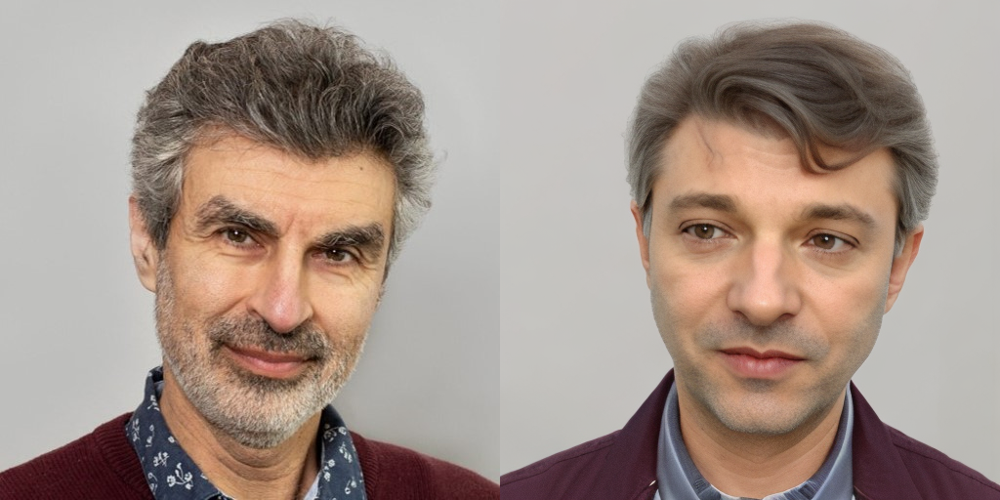

In [3]:
kwargs = sampling_kwargs(prompt = prompt,
                         step = 50,
                         cfg = 5.0,
                         fusion = False,
                        )
image = pipe(ref_image_latent=gt_latents, ref_image_embed=vision_hidden_states, **kwargs).images[0]
image_pretrained_model = get_concat_h(input_img_, image)
print("Results before fine-tuning")
image_pretrained_model.show()

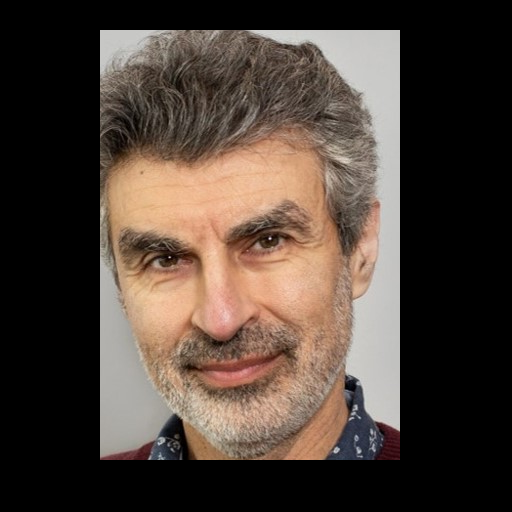

In [4]:
# setting a proper mask
mask = torch.zeros((1, 3, 512, 512)).cuda()
mask[:, :, 30:460, 100:400] += 1
train_transforms = T.Compose(
    [
        T.Resize(512, interpolation=T.InterpolationMode.BILINEAR),
        T.CenterCrop(512),
        T.RandomHorizontalFlip(),
    ]
)
image = ToTensor()(train_transforms(Image.open(test_img).convert('RGB'))).unsqueeze(0).cuda()
T.ToPILImage()((image*mask).squeeze()).show()

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

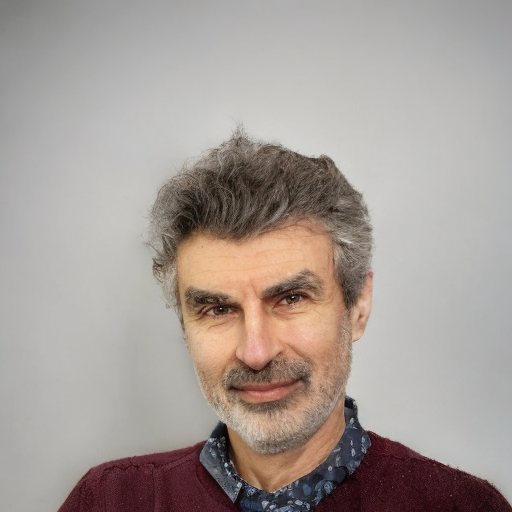

  0%|          | 0/50 [00:00<?, ?it/s]

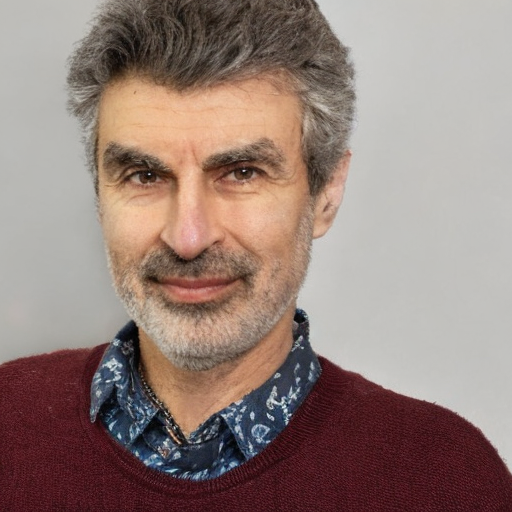

  0%|          | 0/50 [00:00<?, ?it/s]

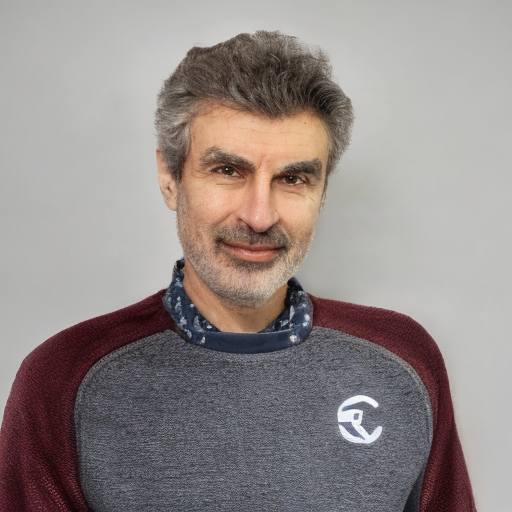

  0%|          | 0/50 [00:00<?, ?it/s]

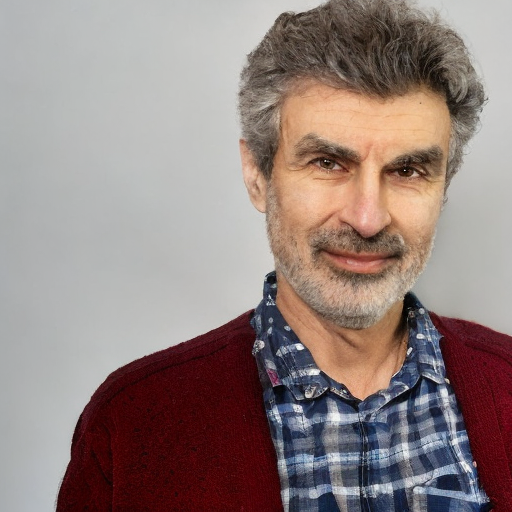

  0%|          | 0/50 [00:00<?, ?it/s]

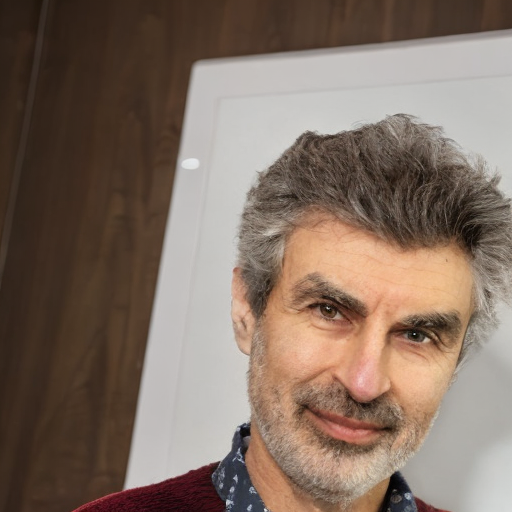

  0%|          | 0/50 [00:00<?, ?it/s]

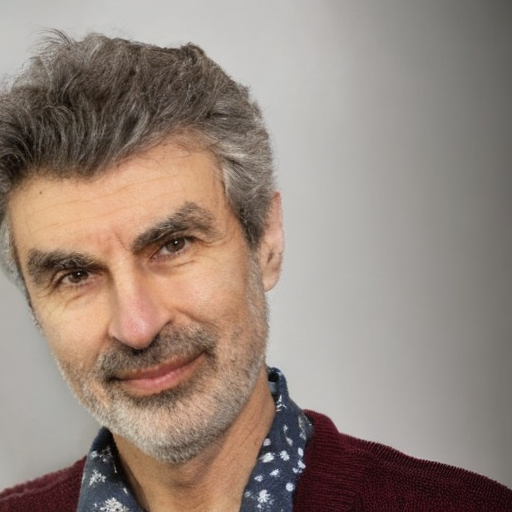

  0%|          | 0/50 [00:00<?, ?it/s]

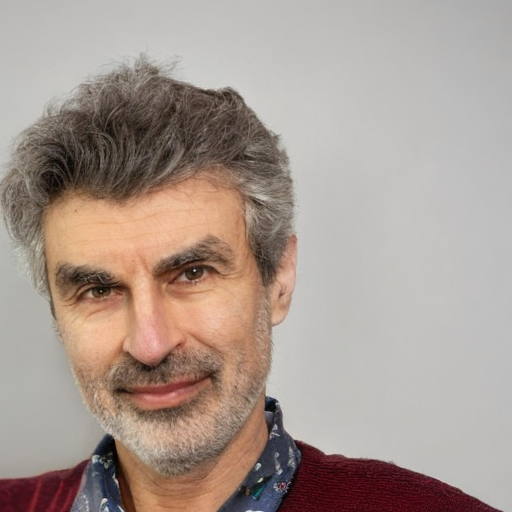

  0%|          | 0/50 [00:00<?, ?it/s]

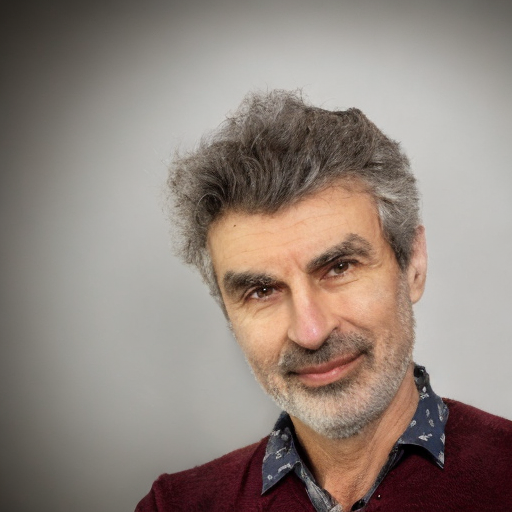

  0%|          | 0/50 [00:00<?, ?it/s]

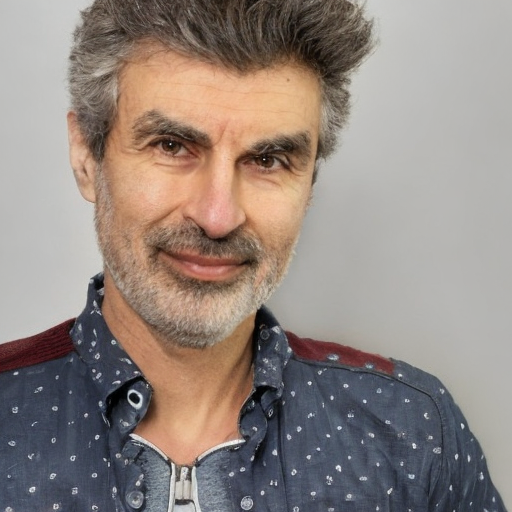

  0%|          | 0/50 [00:00<?, ?it/s]

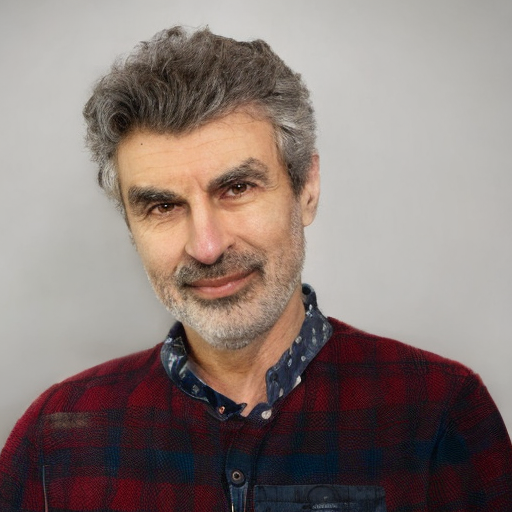

  0%|          | 0/50 [00:00<?, ?it/s]

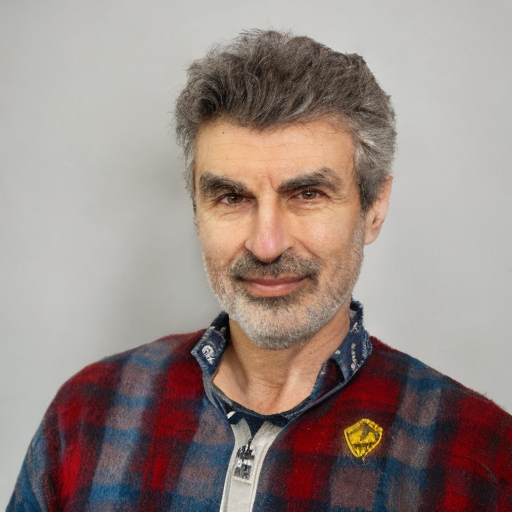

  0%|          | 0/50 [00:00<?, ?it/s]

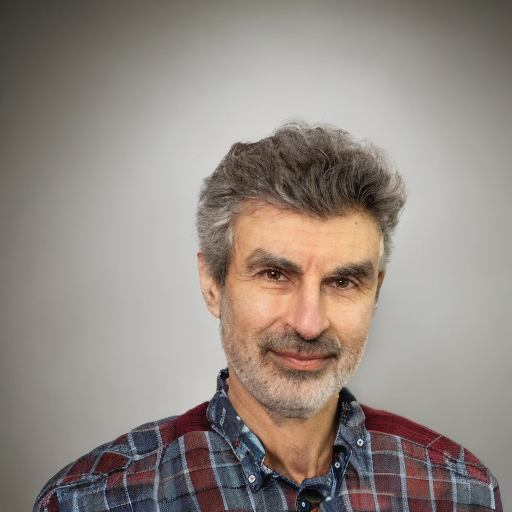

  0%|          | 0/50 [00:00<?, ?it/s]

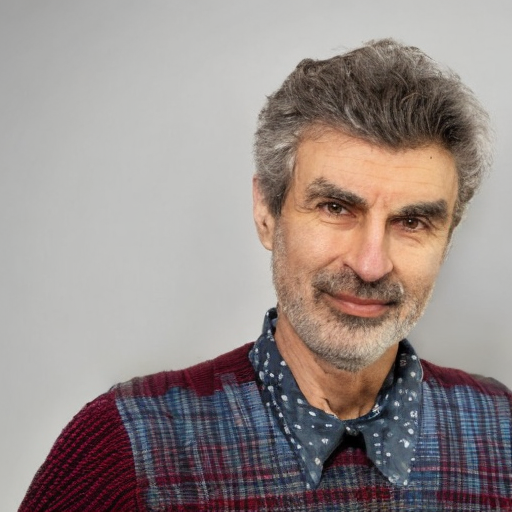

  0%|          | 0/50 [00:00<?, ?it/s]

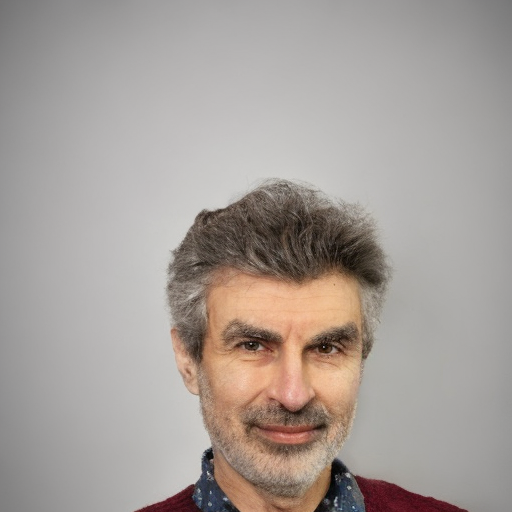

  0%|          | 0/50 [00:00<?, ?it/s]

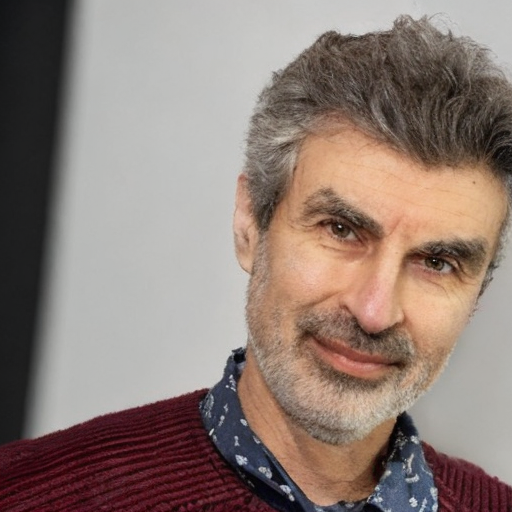

  0%|          | 0/50 [00:00<?, ?it/s]

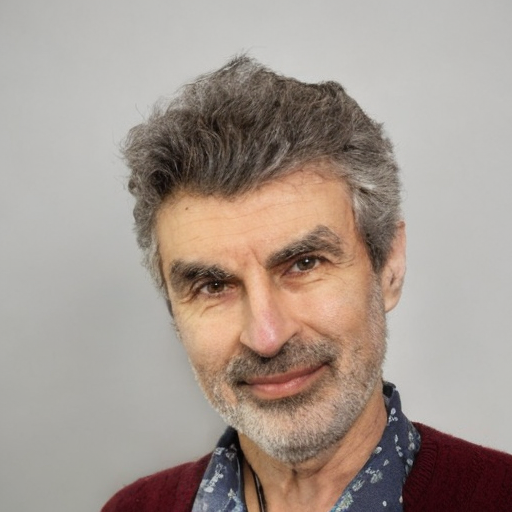

  0%|          | 0/50 [00:00<?, ?it/s]

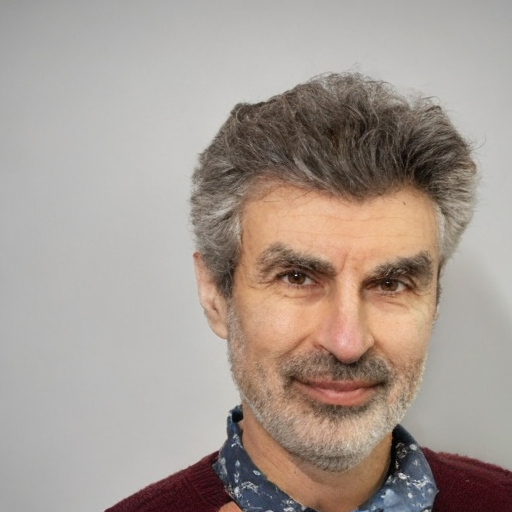

  0%|          | 0/50 [00:00<?, ?it/s]

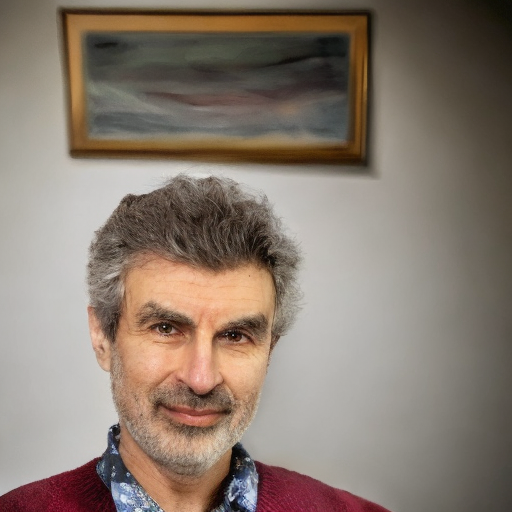

  0%|          | 0/50 [00:00<?, ?it/s]

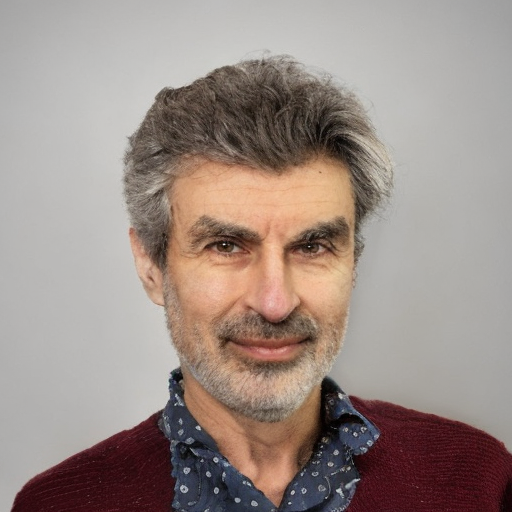

  0%|          | 0/50 [00:00<?, ?it/s]

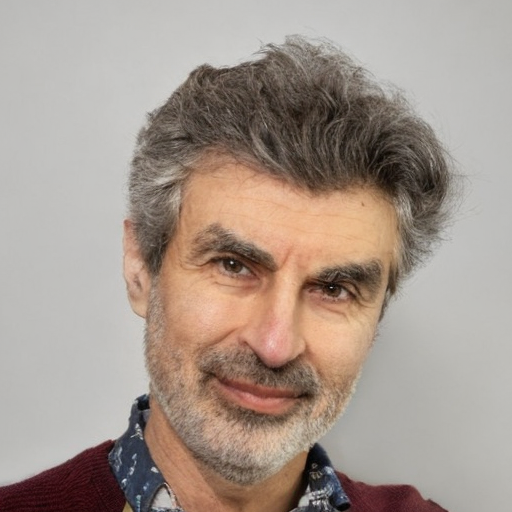

  0%|          | 0/50 [00:00<?, ?it/s]

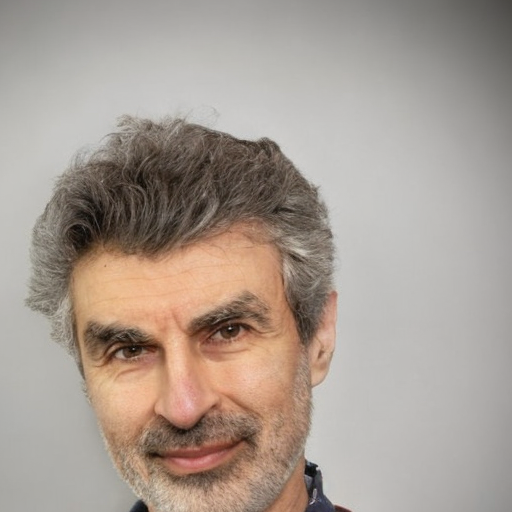

  0%|          | 0/50 [00:00<?, ?it/s]

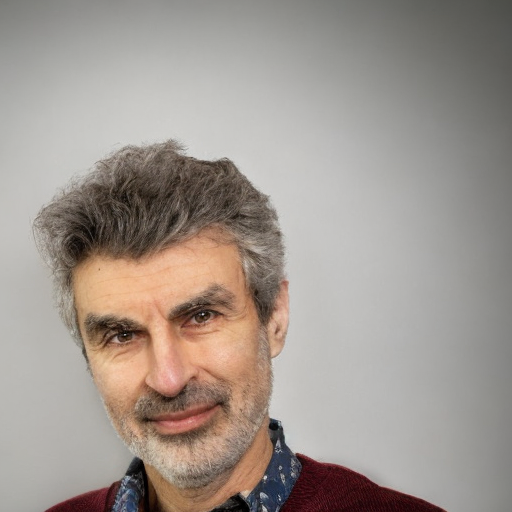

  0%|          | 0/50 [00:00<?, ?it/s]

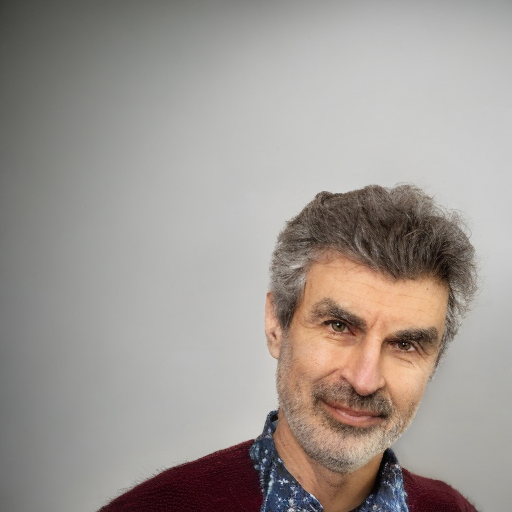

  0%|          | 0/50 [00:00<?, ?it/s]

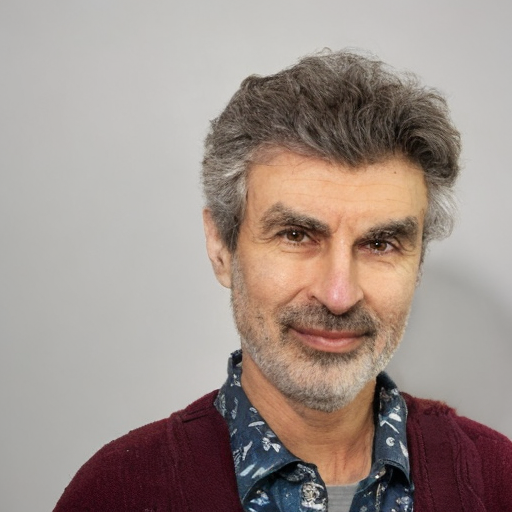

  0%|          | 0/50 [00:00<?, ?it/s]

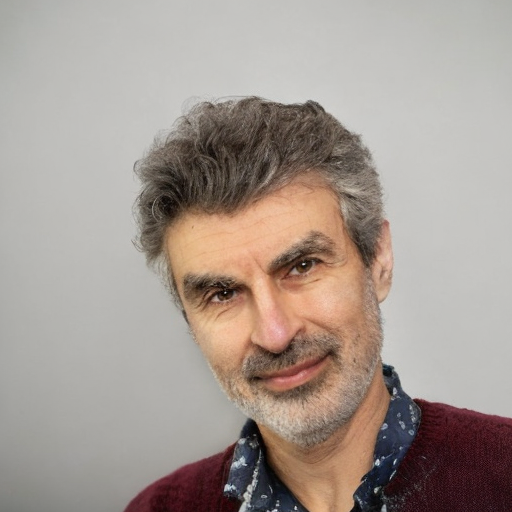

  0%|          | 0/50 [00:00<?, ?it/s]

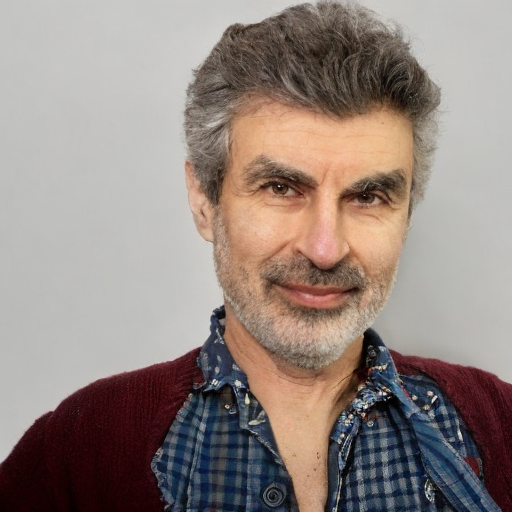

  0%|          | 0/50 [00:00<?, ?it/s]

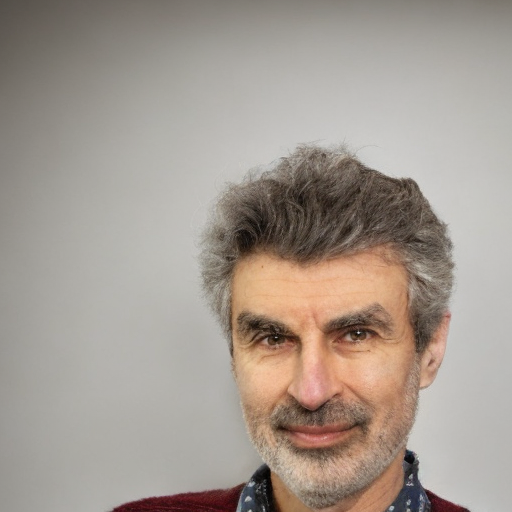

  0%|          | 0/50 [00:00<?, ?it/s]

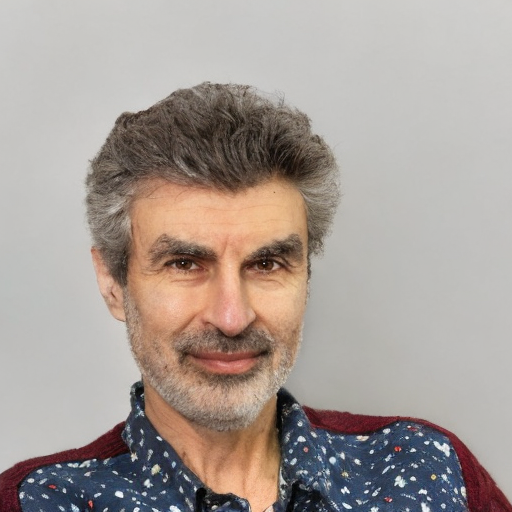

  0%|          | 0/50 [00:00<?, ?it/s]

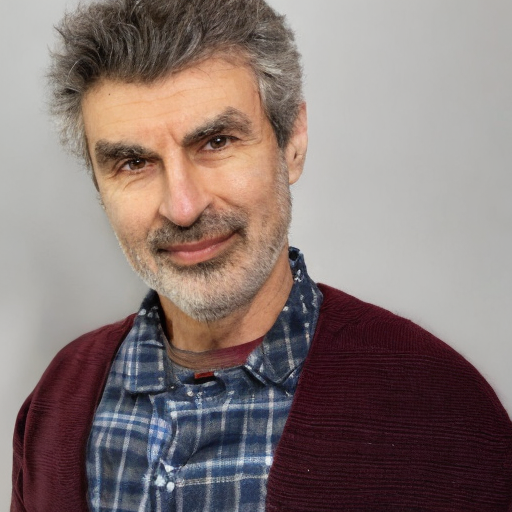

  0%|          | 0/50 [00:00<?, ?it/s]

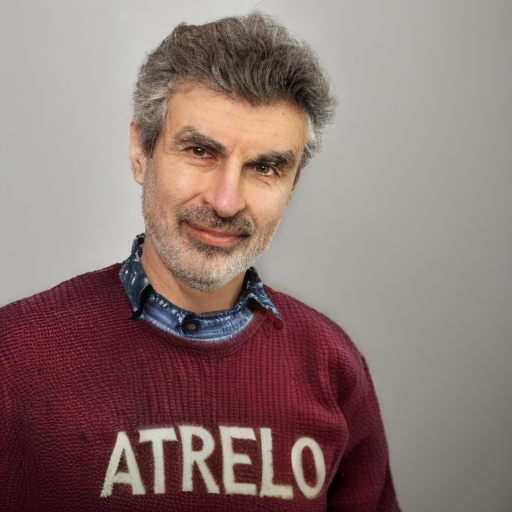

  0%|          | 0/50 [00:00<?, ?it/s]

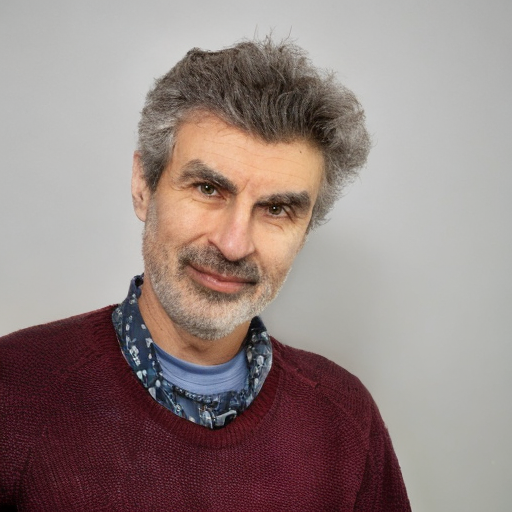

In [5]:
# Prepare a mini dataset
# You can also use real images instead of augmentation

data_augmentation = True # use data augmentation means that we will augment the input image to be a mini dataset
augmentation_scale = (0.6, 1.0) # scale the original image, sometimes this influences the results on some images
num = 31 # number of augmented images
os.makedirs('./mini', exist_ok=True)
train_imgs = []
if data_augmentation:
    # prepare a mini-dataset with the target single image
    train_transforms = T.Compose(
        [
            T.Resize(512, interpolation=T.InterpolationMode.BILINEAR),
            T.CenterCrop(512),
            T.RandomHorizontalFlip(),
        ]
    )
    inpaint_pipe = StableDiffusionInpaintPipeline.from_pretrained("stabilityai/stable-diffusion-2-inpainting",torch_dtype=torch.float16,)
    inpaint_pipe.to("cuda")
    prompt = "a photo of a man, highly detailed, soft natural lighting, photo realism, professional portrait, ultra-detailed, 4k resolution, wallpaper, hd wallpaper"
    negative_prompt = "magzine, frame, tiled, repeated, multiple people, multiple faces, group of people, split frame, multiple panel, split image, watermark, boarder, diptych, triptych"
    to_show_img = input_img_
    with torch.no_grad():
        for j in range(num):
            image = ToTensor()(train_transforms(Image.open(test_img).convert('RGB'))).unsqueeze(0).cuda() + 1e-5
            image *= mask
            image = T.RandomAffine(degrees=(-10, 10), translate=(0.2, 0.2), scale=augmentation_scale)(image)
            mask_image = 1.0 - image.clone().to(dtype=torch.bool).to(dtype=torch.int8)
            image = T.ToPILImage()(image.squeeze())
            mask_image = T.ToPILImage()(mask_image.squeeze())
            # image and mask_image should be PIL images.
            # The mask structure is white for inpainting and black for keeping as is
            image = inpaint_pipe(prompt=prompt, num_inference_steps=50, image=image, mask_image=mask_image, negative_prompt=negative_prompt, guidance_scale=7.5).images[0]
            image.show()
            image.save(f'./mini/{j}.jpg')
            train_imgs.append(image)
            to_show_img = get_concat_h(to_show_img, image)
    # del inpaint_pipe
    inpaint_pipe.to("cpu")   
else:
    for j in range(num):
        train_imgs.append(input_img_)
        input_img_.save(f'./mini/{j}.jpg')
input_img_.save(f'./mini/{num}.jpg')

In [4]:
# Load mini dataset, you can delete some poor quality images
mini_dataset = './mini'
mini_fnames = [os.path.join(r, f) for r, d, fs in os.walk(mini_dataset) for f in fs]
latents_ = []
vision_hidden_states_batch_ = []
print(mini_fnames)
for img_file in mini_fnames:
    if '.ipynb_checkpoints/' not in img_file:
        new_latents, new_vision_hidden_states, new_input_img = process_img(img_file)
        latents_.append(new_latents)
        vision_hidden_states_batch_.append(new_vision_hidden_states)
    
latents_ = torch.cat(latents_).to(gt_latents.device)
vision_hidden_states_batch_ = torch.cat(vision_hidden_states_batch_).to(gt_latents.device)
print(latents_.shape, vision_hidden_states_batch_.shape)

['./mini/0.jpg', './mini/1.jpg', './mini/2.jpg', './mini/3.jpg', './mini/4.jpg', './mini/5.jpg', './mini/6.jpg', './mini/7.jpg', './mini/8.jpg', './mini/9.jpg', './mini/10.jpg', './mini/11.jpg', './mini/12.jpg', './mini/13.jpg', './mini/14.jpg', './mini/15.jpg', './mini/16.jpg', './mini/17.jpg', './mini/18.jpg', './mini/19.jpg', './mini/20.jpg', './mini/21.jpg', './mini/22.jpg', './mini/23.jpg', './mini/24.jpg', './mini/25.jpg', './mini/26.jpg', './mini/27.jpg', './mini/28.jpg', './mini/29.jpg', './mini/30.jpg', './mini/31.jpg']
torch.Size([32, 4, 64, 64]) torch.Size([32, 257, 1280])


In [5]:
# finetune a model
noise_scheduler = DDPMScheduler.from_pretrained(model_path, subfolder="scheduler")
iterations = 100 # more iterations can lead to better results, needed iterations can be very different on different images
batch_size = 4 # choose batch size based on your device, you can use a larger batch size and less iterations
finetune_unet = True
save_path = './saved_model'
# Load mini dataset
mini_dataset = './mini'
mini_fnames = [os.path.join(r, f) for r, d, fs in os.walk(mini_dataset) for f in fs]

# assert latents_.shape[0] >= batch_size

params_to_optimize = list(promptnet.parameters())
if finetune_unet:
    for (name, param) in unet.named_parameters():
        if 'to_q' in name or 'to_k' in name or 'to_v' in name:
            param.requires_grad = True
            params_to_optimize.append(param)


promptnet.to(dtype=torch.float32)
if finetune_unet:
    unet.to(dtype=torch.float32)

optimizer = torch.optim.AdamW(
    params_to_optimize,
    lr=2e-5, 
    betas=(0.9, 0.999),
    weight_decay=1e-2,
    eps=1e-8,
)

accelerator = Accelerator(mixed_precision="fp16")

# promptnet, optimizer = accelerator.prepare(promptnet, optimizer)
if finetune_unet:
    promptnet, unet, optimizer = accelerator.prepare(promptnet,unet, optimizer)
else:
    promptnet, optimizer = accelerator.prepare(promptnet, optimizer)

openclip.to(accelerator.device, dtype=weight_dtype)
vae.to(accelerator.device, dtype=weight_dtype)
if not finetune_unet:
    unet.to(accelerator.device, dtype=weight_dtype)
else:
    unet.train()
promptnet.train()

for epoch in tqdm(range(iterations)):
    # latents_, vision_hidden_states_batch_, _ = process_img(mini_fnames, True)

    idx = torch.randperm(latents_.shape[0])
    ref_latents = latents_[idx][:batch_size]
    vision_hidden_states_batch = vision_hidden_states_batch_[idx][:batch_size]
    idx_2 = torch.randperm(latents_.shape[0])
    latents = latents_[idx_2][:batch_size]
    
    placeholder_pre_prompt_ids = tokenizer("a photo of ", padding=True, return_tensors="pt")["input_ids"]
    placeholder_pre_prompt_ids = placeholder_pre_prompt_ids.reshape(-1)

    noise = torch.randn_like(latents)

    if noise_scheduler.config.prediction_type == "epsilon":
        target = noise
    elif noise_scheduler.config.prediction_type == "v_prediction":
        target = noise_scheduler.get_velocity(latents, noise, timesteps)
    else:
        raise ValueError(f"Unknown prediction type {noise_scheduler.config.prediction_type}")
    bsz = latents.shape[0]

    timesteps = torch.randint(0, noise_scheduler.num_train_timesteps, (bsz,), device=latents.device)

    noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)
    
    pseudo_prompt, _, _ = promptnet(sample=ref_latents, timestep=timesteps, encoder_hidden_states=vision_hidden_states_batch, promptnet_cond=noisy_latents, return_dict=False, )
    
    placeholder_prompt_ids = torch.cat([placeholder_pre_prompt_ids[:-1].to(latents.device), torch.tensor([0] * pseudo_prompt.shape[1]).to(latents.device), placeholder_pre_prompt_ids[-1:].to(latents.device)], dim=-1)
    
    pseudo_hidden_states = text_encoder.embeddings(placeholder_prompt_ids)
    pseudo_hidden_states = pseudo_hidden_states.repeat((pseudo_prompt.shape[0], 1, 1))
    pseudo_hidden_states[:, len(placeholder_pre_prompt_ids) - 1: pseudo_prompt.shape[1] + len(placeholder_pre_prompt_ids) - 1, :] = pseudo_prompt 
    causal_attention_mask = text_encoder._build_causal_attention_mask(pseudo_hidden_states.shape[0], pseudo_hidden_states.shape[1], pseudo_hidden_states.dtype).to(pseudo_hidden_states.device)
    encoder_outputs = text_encoder.encoder(pseudo_hidden_states, causal_attention_mask=causal_attention_mask, output_hidden_states=True)
    encoder_hidden_states = text_encoder.final_layer_norm(encoder_outputs.hidden_states[-2]).to(dtype=latents.dtype)

    outputs_ = unet(noisy_latents, timesteps, encoder_hidden_states, down_block_additional_residuals=None, mid_block_additional_residual=None, res_scale=0.0)

    loss = ((outputs_.sample.float() - target.float()) ** 2).mean((1, 2, 3)).mean()
    accelerator.backward(loss)
    # if accelerator.sync_gradients:
        # accelerator.clip_grad_norm_(promptnet.parameters(), 1.0)

    optimizer.step()
    optimizer.zero_grad()
    
# save the model you just trained
pipeline = StableDiffusionPromptNetPipeline.from_pretrained(
    model_path,
    openclip=openclip,
    vae=vae,
    unet=accelerator.unwrap_model(unet),
    promptnet=accelerator.unwrap_model(promptnet),
    tokenizer=tokenizer,
)
pipeline.save_pretrained(save_path)
print(f"The model has been saved to {save_path}")

100%|██████████| 100/100 [00:49<00:00,  2.00it/s]


The model has been saved to ./saved_model


In [6]:
# load the trained model
save_path = './saved_model'
scheduler = DDIMScheduler.from_pretrained(save_path, subfolder="scheduler")  # must use DDIM when refine_step > 0
if use_fp16:
    pipe = StableDiffusionPromptNetPipeline.from_pretrained(save_path, scheduler=scheduler, torch_dtype=torch.float16)
    weight_dtype = torch.float16
else:
    pipe = StableDiffusionPromptNetPipeline.from_pretrained(save_path, scheduler=scheduler)
    weight_dtype = torch.float32
pipe.to("cuda")
print(f"Model loaded from {save_path}")

The config attributes {'center_input_sample': False, 'conv_out_kernel': 3, 'up_block_types': ['UpBlock2D', 'CrossAttnUpBlock2D', 'CrossAttnUpBlock2D', 'CrossAttnUpBlock2D'], 'with_ebm': False} were passed to PromptNetModel, but are not expected and will be ignored. Please verify your config.json configuration file.


Model loaded from ./saved_model


  0%|          | 0/50 [00:00<?, ?it/s]

Results before fine-tuning.


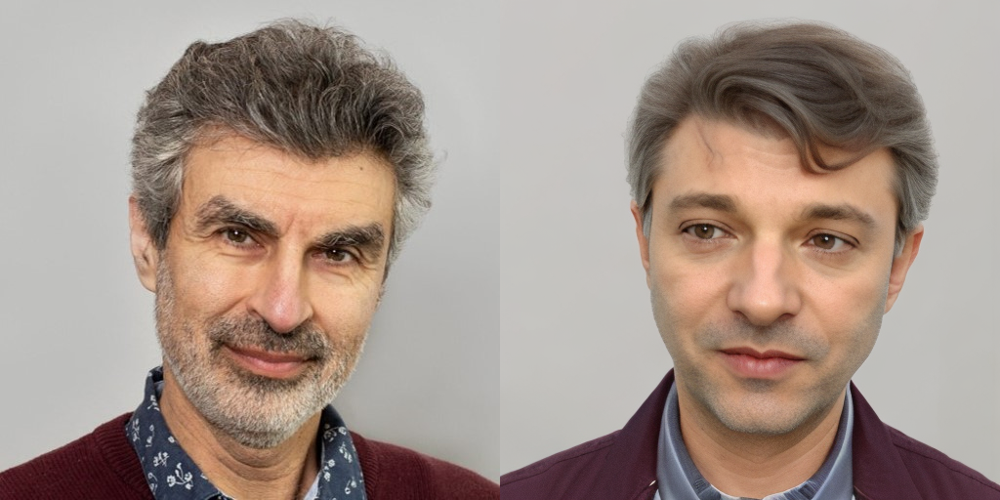

Results after fine-tuning, WITHOUT fusion sampling


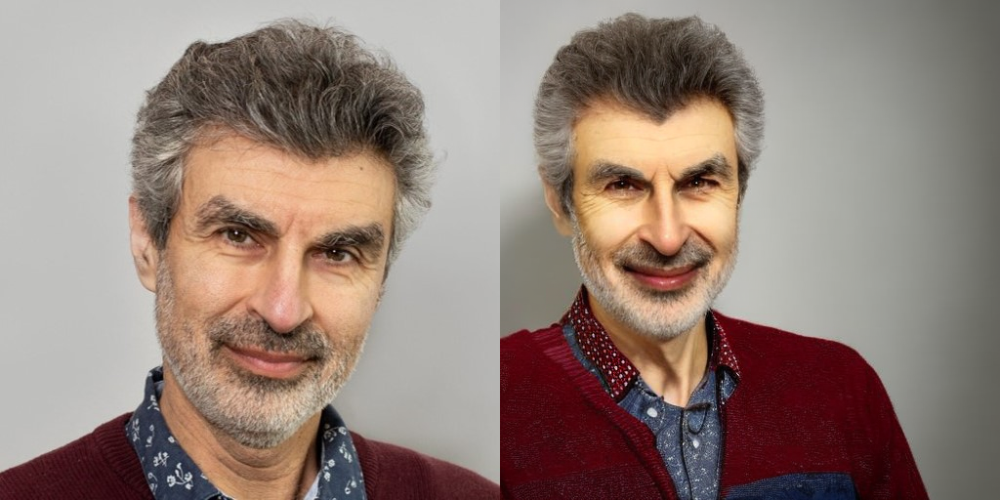

Results after fine-tuning, WITH fusion sampling


  0%|          | 0/50 [00:00<?, ?it/s]

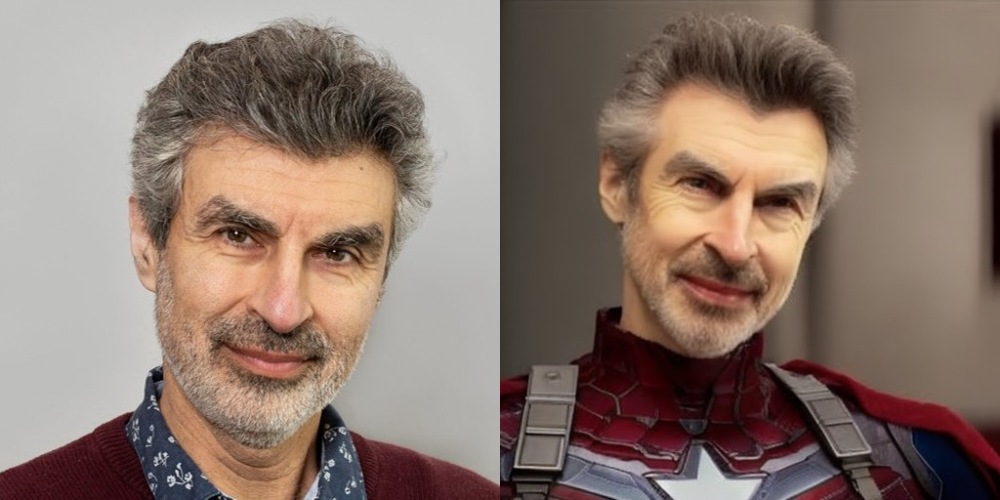

In [9]:
# test the model you just trained
torch.manual_seed(0)

# prompt = "in Ghibli anime style, trending on pixiv fanbox"
prompt = "from a Marvel superhero movie screenshot"

gt_latents, vision_hidden_states, input_img_ = process_img(test_img)
kwargs = sampling_kwargs(prompt = prompt,
                         step = 50,
                         cfg = 5.0,
                         fusion = False,
                        )
image = pipe(ref_image_latent=gt_latents, ref_image_embed=vision_hidden_states, **kwargs).images[0]
image_finetuned_model = get_concat_h(input_img_, image)

print("Results before fine-tuning.")
image_pretrained_model.show()
print("Results after fine-tuning, WITHOUT fusion sampling")
image_finetuned_model.show()

# proposed fusion sampling
kwargs = sampling_kwargs(prompt = prompt,
                         step = 50, # sampling steps
                         cfg = 7.0, # increase this if you want more information from the input image. decrease this when you find information from image is too strong (fails to generate according to text)
                         ref_cfg = 5.0, # increase this if you want more information from the prompt 
                         fusion = True, # use fusion sampling or not
                         refine_step = 1, # when fusion=True, refine_step=0 means we consider conditions to be independent, refine_step>0 means we consider them as dependent
                         refine_emb_scale = 0.6, # increase this if you want some more information from input image, decrease if text information is not correctly generated. Normally 0.4~0.9 should work.
                         refine_cfg=7.0, # guidance for fusion step sampling
                        )
gt_latents, vision_hidden_states, input_img_ = process_img(test_img)
print("Results after fine-tuning, WITH fusion sampling")
image = pipe(ref_image_latent=gt_latents, ref_image_embed=vision_hidden_states, 
             **kwargs).images[0]
get_concat_h(input_img_, image).show()

The config attributes {'up_block_types': ['UpBlock2D', 'CrossAttnUpBlock2D', 'CrossAttnUpBlock2D', 'CrossAttnUpBlock2D']} were passed to PromptNetModel, but are not expected and will be ignored. Please verify your config.json configuration file.


Model ./identity_small has been loaded


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

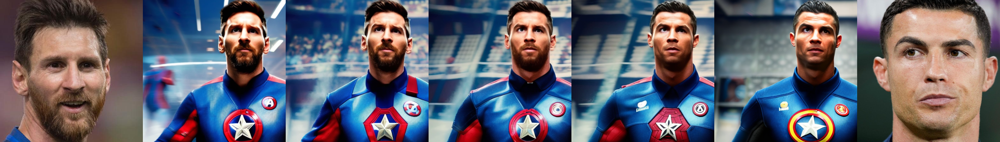

In [1]:
# Example of generation with more than one input images

# This can actually be extended to generation with tens, hundreds of image inputs 

# (Although it is unlikely that we really need that many input images)

import torch
import os
from torch import nn
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from diffusers import StableDiffusionPromptNetPipeline, StableDiffusionInpaintPipeline
from transformers import AutoProcessor, CLIPModel
from torchvision.transforms import InterpolationMode
from tqdm import tqdm
from accelerate import Accelerator
import torchvision.transforms as T
import random

BICUBIC = InterpolationMode.BICUBIC
from PIL import Image
from diffusers import StableDiffusionPipeline, EulerDiscreteScheduler, DDIMScheduler, DDPMScheduler

def sampling_kwargs(step=50, prompt="in Ghibli style", cfg=5.0, ref_cfg=5.0, residual=0.0, fusion=True, 
                    refine_step=0, refine_eta=1., refine_emb_scale=0.7, refine_cfg=5.0):
    kwargs = {}
    kwargs["num_inference_steps"] = step 
    kwargs["prompt"] = "a holder " + prompt 
    kwargs["guidance_scale"] = cfg 
    kwargs["res_prompt_scale"] = residual
    if fusion: # if we use a reference prompt for structure information fusion
        kwargs["ref_prompt"] = "a person  " + prompt
        kwargs["guidance_scale_ref"] = ref_cfg  # also can use different scale
        kwargs["refine_step"] = refine_step  # when refine_step == 0, it means we assume conditions are independent (which leads to worse results)
        kwargs["refine_eta"] = refine_eta
        kwargs["refine_emb_scale"] = refine_emb_scale 
        kwargs["refine_guidance_scale"] = refine_cfg            
    else:
        kwargs["ref_prompt"] = None
        kwargs["guidance_scale_ref"] = 0.
        kwargs["refine_step"] = 0
    return kwargs


def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst


def process_img(img_file, random=False):
    if type(img_file) == str:
        img_file = [img_file]
        
    input_img = []
    for img in img_file:
        image = Image.open(img).convert('RGB')
        w, h = image.size
        crop = min(w, h)
        if random:
            image = T.Resize(560, interpolation=T.InterpolationMode.BILINEAR)(image)
            image = T.RandomCrop(512)(image)
            image = T.RandomHorizontalFlip()(image)
        else:
            image = image.crop(((w - crop) // 2, (h - crop) // 2, (w + crop) // 2, (h + crop) // 2))
        input_img_ = image = image.resize((512, 512), Image.LANCZOS)
        input_img.append(ToTensor()(image).unsqueeze(0))
    input_img = torch.cat(input_img).to("cuda").to(vae.dtype)
    img_latents = vae.encode(input_img * 2.0 - 1.0).latent_dist.sample()
    img_latents = img_latents * vae.config.scaling_factor

    img_4_clip = processor(input_img)
    vision_embeds = openclip.vision_model(img_4_clip, output_hidden_states=True)
    vision_hidden_states = vision_embeds.last_hidden_state
    return img_latents, vision_hidden_states, input_img_


processor = Compose([
    Resize(224, interpolation=BICUBIC),
    Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711)),
])

model_path = "./identity_small" # this model can be found at https://drive.google.com/file/d/1TPPKLqkUno1WvM_cTNTZSxfzE6GTV3Xz/view?usp=share_link, which is a model fine-tuned on some celebraties images
use_fp16 = True
scheduler = DDIMScheduler.from_pretrained(model_path, subfolder="scheduler")  # must use DDIM when refine_step > 0

if use_fp16:
    pipe = StableDiffusionPromptNetPipeline.from_pretrained(model_path, scheduler=scheduler, torch_dtype=torch.float16)
    weight_dtype = torch.float16
else:
    pipe = StableDiffusionPromptNetPipeline.from_pretrained(model_path, scheduler=scheduler)
    weight_dtype = torch.float32
    
pipe.to("cuda")
vae = pipe.vae
tokenizer = pipe.tokenizer
openclip = pipe.openclip
text_encoder = openclip.text_model
vision_encoder = openclip.vision_model
promptnet = pipe.promptnet
unet = pipe.unet

# Freeze vae and text_encoder
vae.requires_grad_(False)
openclip.requires_grad_(False)
unet.requires_grad_(False)

print(f"Model {model_path} has been loaded")
test_img = './test_imgs/messi.jpg'
prompt= "from a Marvel superhero movie screenshot"
gt_latents, vision_hidden_states, input_img_ = process_img(test_img)
test_img_2 = './test_imgs/cr7.jpg'
gt_latents_2, vision_hidden_states_2, input_img_2 = process_img(test_img_2)
cfg_1 = [5.0, 4.0, 3.0, 2.0, 1.0]
cfg_2 = [1.0, 2.0, 3.0, 4.0, 5.0]
to_show_img = input_img_
for i in range(len(cfg_1)):
    torch.manual_seed(7)
    kwargs = sampling_kwargs(prompt = prompt,
                             step = 50, # sampling steps
                             cfg = cfg_1[i], # increase this if you want more information from the input image
                             ref_cfg = 5.0, # increase this if you want more information from the prompt 
                             residual = 0., # 
                             fusion = True, # use fusion sampling or not
                             refine_step = 1, # when fusion=True, refine_step=0 means we consider conditions to be independent, refine_step>0 means we consider them as dependent
                             refine_emb_scale = 0.8, # increase this if you want some more information from input image
                             refine_cfg=7.0, # guidance for fusion sampling
                            )
    image = pipe(ref_image_latent=gt_latents, ref_image_embed=vision_hidden_states, extra_ref_image_latents=[gt_latents_2], extra_ref_image_embeds=[vision_hidden_states_2], extra_ref_image_scales=[cfg_2[i]], **kwargs).images[0]
    to_show_img = get_concat_h(to_show_img, image)
to_show_img = get_concat_h(to_show_img, input_img_2)
to_show_img.show()
